In [2]:
import pandas as pd

In [4]:
df=pd.read_csv('/Users/antoniobravomunoz/Documents/DATA_SCIENCE_MASTER/TFM/Data-Science-Master-project/DATA/df_0518_uniqueMP.csv') 

**Selecting unique values for each ID Measurement Point and saving it in a csv file**

df_0518_uniqueMP=df_0518_test

df_0518_uniqueMP.sort_values('id', axis=0, inplace=True)
df_0518_uniqueMP.drop_duplicates('id', keep="first", inplace=True)
df_0518_uniqueMP.sort_index(inplace=True) 

df_0518_uniqueMP.shape

df_0518_uniqueMP.to_csv('/Users/antoniobravomunoz/Documents/DATA_SCIENCE_MASTER/TFM/Data-Science-Master-project/DATA/df_0518_uniqueMP.csv',index=False)

## **Representing measurement points. Altair**

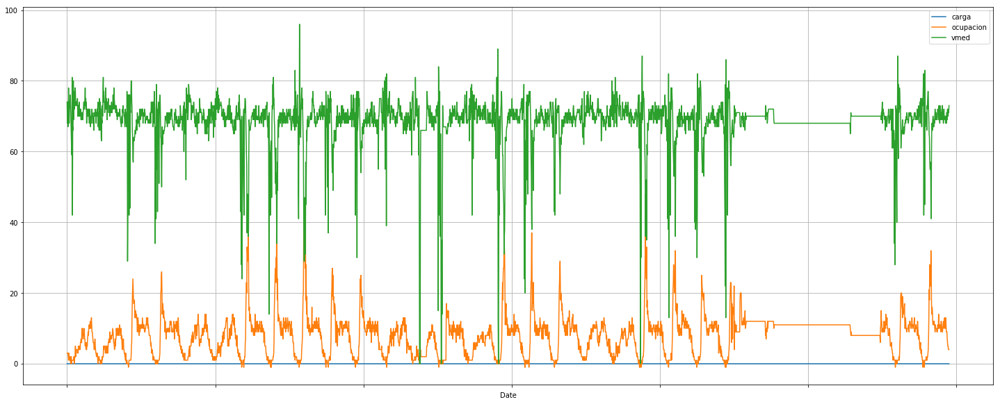

In [74]:
import matplotlib.pyplot as plt
%matplotlib inline
df.loc[df['id'] == 1002].plot(x='Date',y=['carga','ocupacion','vmed'],figsize=(25,10),grid=True)

In [6]:
import altair as alt
alt.renderers.enable('notebook')

RendererRegistry.enable('notebook')

In [56]:
import folium
#Madrid Lat and Long: 40.41,-3.7
m=folium.Map(location=[40.41,-3.7],zoom_start=11)
m

In [13]:
from altair import pipe, limit_rows, to_values
t = lambda data: pipe(data, limit_rows(max_rows=10000), to_values)
alt.data_transformers.register('custom', t)
alt.data_transformers.enable('custom')

DataTransformerRegistry.enable('custom')

dropping NA values

In [17]:
df_noNan=df.dropna(axis=0)

In [18]:
df_noNan.shape

(4020, 15)

In [61]:
for i, row in df_noNan.iterrows():
    folium.Circle(
    radius=10,
    location=[row['Lat'],row['Long']],
    popup='Sensor',
    color='#3190cc',
    fill_color='#3190cc',
    fill=True
).add_to(m)
m

In [64]:
def color_range(tp):
    if tp=='URB':
        return '#3190cc'
    else:
        return 'crimson'

In [80]:
m2=folium.Map(location=[40.41,-3.7],tiles='Stamen Toner',zoom_start=11)

for i, row in df_noNan.iterrows():
    folium.Circle(
    radius=15,
    location=[row['Lat'],row['Long']],
    popup='Sensor',
    color=color_range(row['tipo_elem']),
    fill_color=color_range(row['tipo_elem']),
    fill=True
).add_to(m2)
m2

In [ ]:
m.save('VISUALIZATION_DATA/MeasurementPoints_representation_mode1.html')
m2.save('VISUALIZATION_DATA/MeasurementPoints_representation_mode2.html')